<a href="https://colab.research.google.com/github/danial-amin/Coursera-DeeplearningAI-TensorFlow/blob/main/Automat_5_18_10_22.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import sys
import os
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt 
import pickle
from mpl_toolkits.mplot3d import axes3d
import matplotlib.pyplot as plt
from matplotlib import cm
from google.colab import files

In [2]:
with open('saved_results.pkl', 'rb') as f:
    loaded_dict = pickle.load(f)

In [3]:
Names=list(loaded_dict.keys())

In [4]:
distribution={}
for n in Names:
  distribution[n]=loaded_dict[n]["distrbution"]
distrib=pd.DataFrame(distribution).transpose()
distrib=distrib.rename({"0":"Low LCE","1":"High LCE","t":"Total Instances"},axis=1)
distrib["Ratio 1:0"]=distrib["High LCE"]/distrib["Low LCE"]
distrib["Ratio 1:T"]=distrib["High LCE"]/distrib["Total Instances"]
distrib["Ratio 0:T"]=distrib["Low LCE"]/distrib["Total Instances"]
print(distrib.sort_values(by=["Ratio 1:0","Ratio 1:T","Ratio 0:T"],ascending=False).head())

                                             Low LCE  High LCE  \
S: Random Over O: Local Outlier Factor           222       344   
S: ADSYN O: Local Outlier Factor                 207       289   
S: Cluser Centroids O: Local Outlier Factor       62        85   
S: SMOTE O: Local Outlier Factor                 223       287   
S: ADSYN O: Isolation Forest                     310       358   

                                             Total Instances  Ratio 1:0  \
S: Random Over O: Local Outlier Factor                   566   1.549550   
S: ADSYN O: Local Outlier Factor                         496   1.396135   
S: Cluser Centroids O: Local Outlier Factor              147   1.370968   
S: SMOTE O: Local Outlier Factor                         510   1.286996   
S: ADSYN O: Isolation Forest                             668   1.154839   

                                             Ratio 1:T  Ratio 0:T  
S: Random Over O: Local Outlier Factor        0.607774   0.392226  
S: ADSYN O: Loca

In [5]:
def distributor(X,n="Without Sampling"):
  plt.figure(figsize=(10,5))
  plt.bar([X["0"]/X["t"],X["1"]/X["t"]])
  plt.xticks(ticks=[0,1], labels=["Low LCE", "High LCE"])
  plt.xlabel("LCE Classes")
  plt.ylabel("Percentage")
  plt.title("Distribution of Classificaiton Labels "+n, fontsize=20)
  plt.show()
  plt.savefig("Class Bal-"+n+'.png')

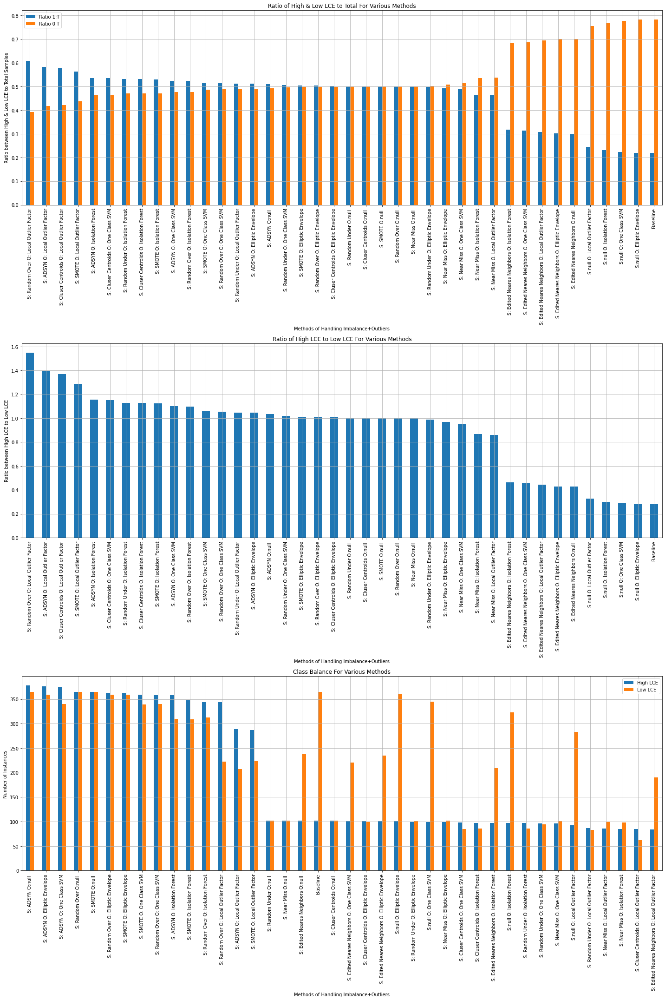

<Figure size 432x288 with 0 Axes>

In [6]:
from matplotlib import figure
fig,ax=plt.subplots(3,1,figsize=(20,30))
distrib[['Ratio 1:T','Ratio 0:T']].sort_values(by='Ratio 1:T',ascending=False).plot(kind='bar',ax=ax[0])
ax[0].set_xlabel("Methods of Handling Imbalance+Outliers")
ax[0].set_ylabel("Ratio between High & Low LCE to Total Samples")
ax[0].set_title("Ratio of High & Low LCE to Total For Various Methods")
ax[0].grid()
distrib['Ratio 1:0'].sort_values(ascending=False).plot(kind='bar',ax=ax[1])
ax[1].set_xlabel("Methods of Handling Imbalance+Outliers")
ax[1].set_ylabel("Ratio between High LCE to Low LCE")
ax[1].set_title("Ratio of High LCE to Low LCE For Various Methods")
ax[1].grid()
distrib[['High LCE','Low LCE']].sort_values(by='High LCE',ascending=False).plot(kind='bar',ax=ax[2])
ax[2].set_xlabel("Methods of Handling Imbalance+Outliers")
ax[2].set_ylabel("Number of Instances ")
ax[2].set_title("Class Balance For Various Methods")
ax[2].grid()
plt.tight_layout()
plt.show()
plt.savefig('Class Bal All.png')

In [7]:
confmat={}
for n in Names:
  confmat[n]=loaded_dict[n]["conf matrix"]
estNames=list(confmat[n].keys())
print(estNames)


['kNN', 'Logistic', 'Decision Tree', 'SVM', 'Random Forest', 'AdaBoost', 'GradientBoost', 'HistGradBooster', 'XGBoost', 'LightBoost', 'CatBoost']


In [8]:
def conv(s,a,b=0):
  temp={}
  for n in Names:
    est={}
    for i in estNames:
      est[i]=loaded_dict[n]["matrices"][i][s].mean()
    temp[n]=est
  temp_d=pd.DataFrame(temp)
  temp_d.to_csv(s+".csv")
  fig,ax=plt.subplots(1,1,figsize=(14,32))
  temp_d[[s for s in list(temp_d.columns) if "S:null" in s or s=="Baseline"]].plot(ax=ax)
  ax.set_xticks(list(range(len(estNames))))
  ax.set_xlabel("Estimators")
  ax.set_ylabel("Mean "+a+" of 5 Folds")
  ax.set_title("Mean "+a+" of 5 Folds"+" trained various estimators for Outlier Detection and Removal Mechanism")
  ax.grid()
  ax.set_xticklabels(estNames);
  plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=5.0)
  plt.savefig(a+'Matrices-O'+'.png');
  if b==1:
    plt.show()
  fig,ax=plt.subplots(1,1,figsize=(14,32))
  temp_d[[s for s in list(temp_d.columns) if "O:null" in s or s=="Baseline"]].plot(ax=ax)
  ax.set_xticks(list(range(len(estNames))))
  ax.set_xlabel("Estimators")
  ax.set_ylabel("Mean "+a+" of 5 Folds")
  ax.set_title("Mean "+a+" of 5 Folds"+" trained various estimators for Different Sampling Mechanism")
  ax.grid()
  ax.set_xticklabels(estNames);
  plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=5.0)
  plt.savefig(a+'Matrices-S'+'.png');
  if b==1:
    plt.show()
  fig,ax=plt.subplots(1,1,figsize=(14,32))
  temp_d[[s for s in list(temp_d.columns) if "null" not in s or s=="Baseline"]].plot(ax=ax)
  ax.set_xticks(list(range(len(estNames))))
  ax.set_xlabel("Estimators")
  ax.set_ylabel("Mean "+a+" of 5 Folds")
  ax.set_title("Mean "+a+" of 5 Folds"+" trained various estimators for Different Sampling & Outlier Detection & Removal Mechanism")
  ax.grid()
  ax.set_xticklabels(estNames)
  plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=5.0);
  plt.savefig(a+'Matrices-SO'+'.png');
  if b==1:
    plt.show()
  def f(x, y):
    return temp_d.transpose().values[x,y]
  x = range(len(Names))
  y = range(len(estNames))

  X, Y = np.meshgrid(x, y)
  Z = f(X, Y)
  norm = plt.Normalize(Z.min(), Z.max())
  colors = cm.viridis_r(norm(Z))
  rcount, ccount, _ = colors.shape

  fig = plt.figure(figsize=(40,25))
  ax = fig.gca(projection='3d')
  plt.tight_layout(pad=0.4, w_pad=5, h_pad=10.0)
  surf = ax.plot_surface(Y, X, Z, rcount=rcount, ccount=ccount,
                        facecolors=colors, shade=False)
  surf.set_facecolor((0,0,0,0))
  ax.set_ylabel("Methods for Handling Class Imbalance & Outliers")
  ax.set_xlabel("Estimators")
  ax.set_zlabel("Mean "+a+" of 5 Folds")
  ax.set_title("Mean "+a+" of 5 Folds"+" trained various estimators for Different Sampling & Outlier Detection & Removal Mechanism")
  ax.set_yticks(x)
  ax.set_yticklabels(Names)
  ax.set_xticks(y)
  ax.set_xticklabels(estNames)
  ax.tick_params(axis='y', labelrotation=90)
  ax.xaxis.labelpad = 20
  ax.yaxis.labelpad = 165
  ax.view_init(30, -10)
  plt.savefig(a+'Matrices-3D'+'.png')
  plt.show()


In [9]:
matr=list(loaded_dict[Names[0]]["matrices"][estNames[0]].keys())[2:]
print(matr)

['test_accu', 'train_accu', 'test_prec', 'train_prec', 'test_recall', 'train_recall', 'test_f1', 'train_f1', 'test_mcc', 'train_mcc', 'test_ras', 'train_ras']


In [10]:
a=["Test","Train"]
b=["Accuracy","Precision","Recall","F1","MCC","ROC AUC Score"]
mat_name=[]
for i in range(len(b)):
  for j in range(len(a)):
    mat_name.append(a[j]+" "+b[i])
print(mat_name)

['Test Accuracy', 'Train Accuracy', 'Test Precision', 'Train Precision', 'Test Recall', 'Train Recall', 'Test F1', 'Train F1', 'Test MCC', 'Train MCC', 'Test ROC AUC Score', 'Train ROC AUC Score']


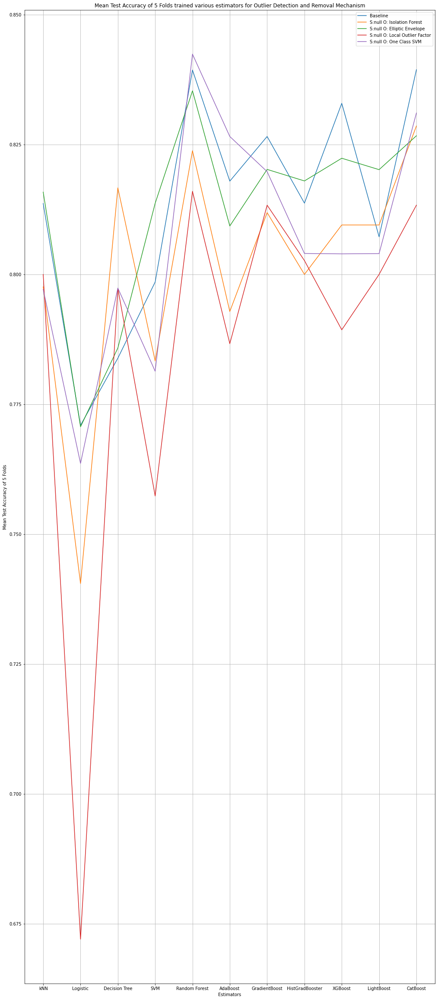

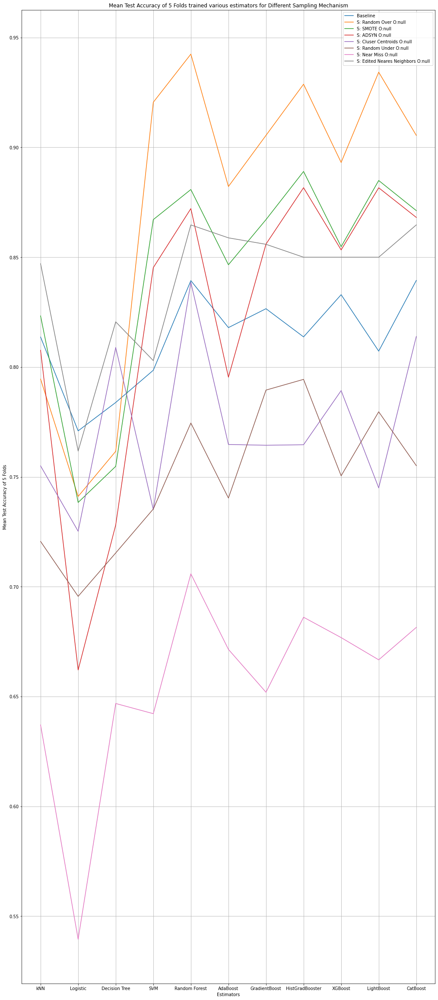

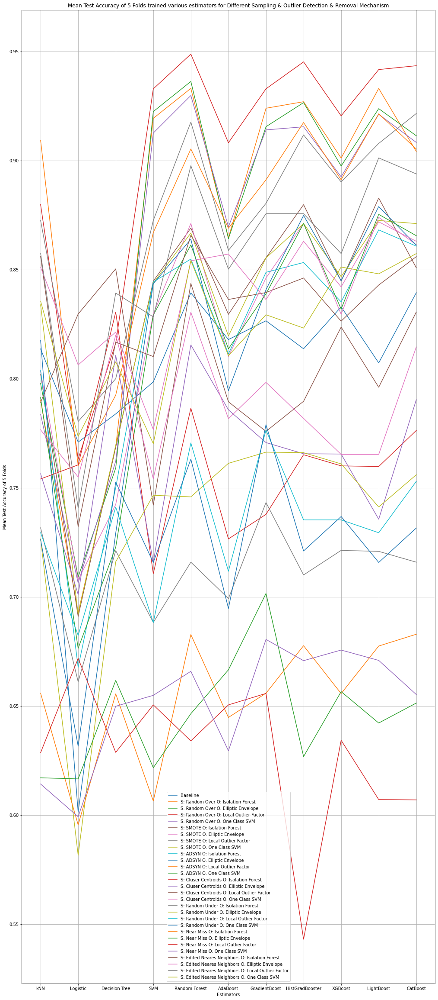

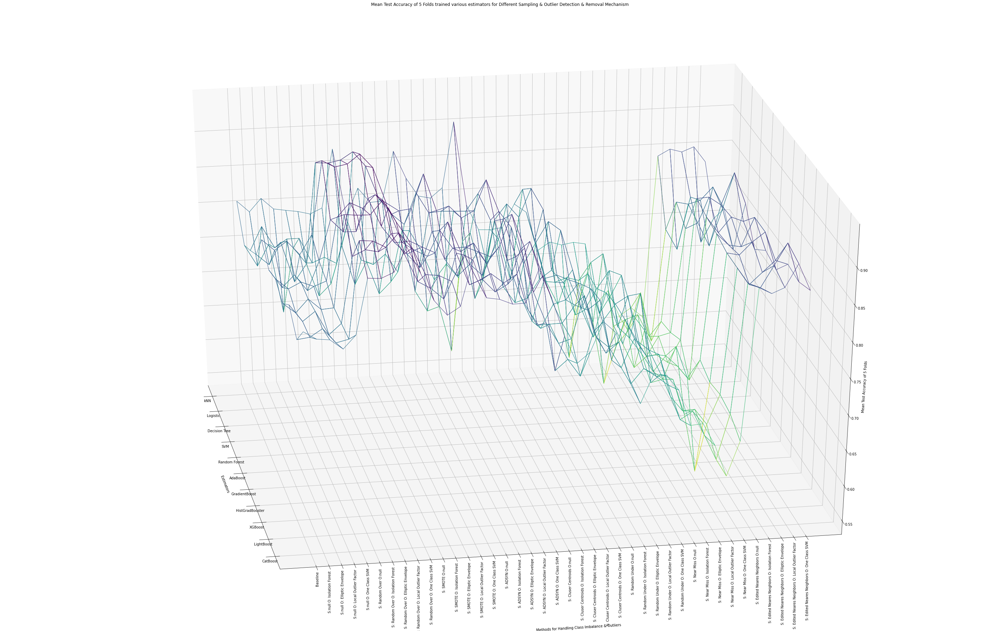

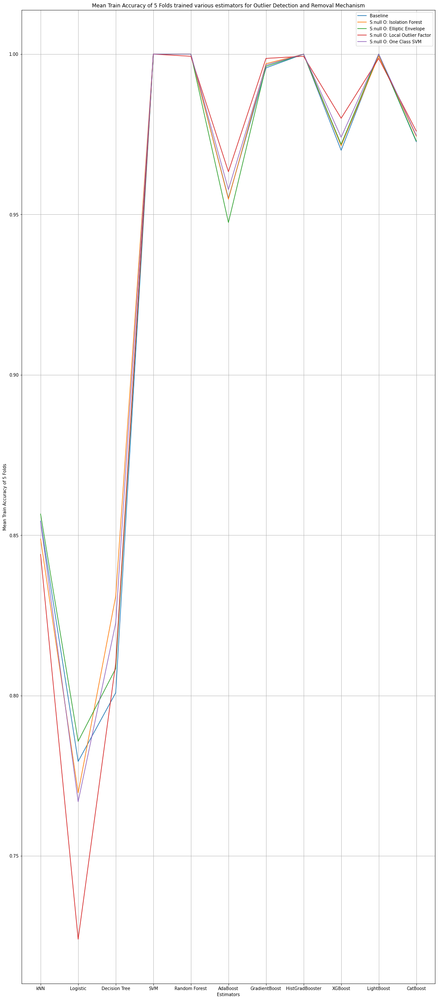

...

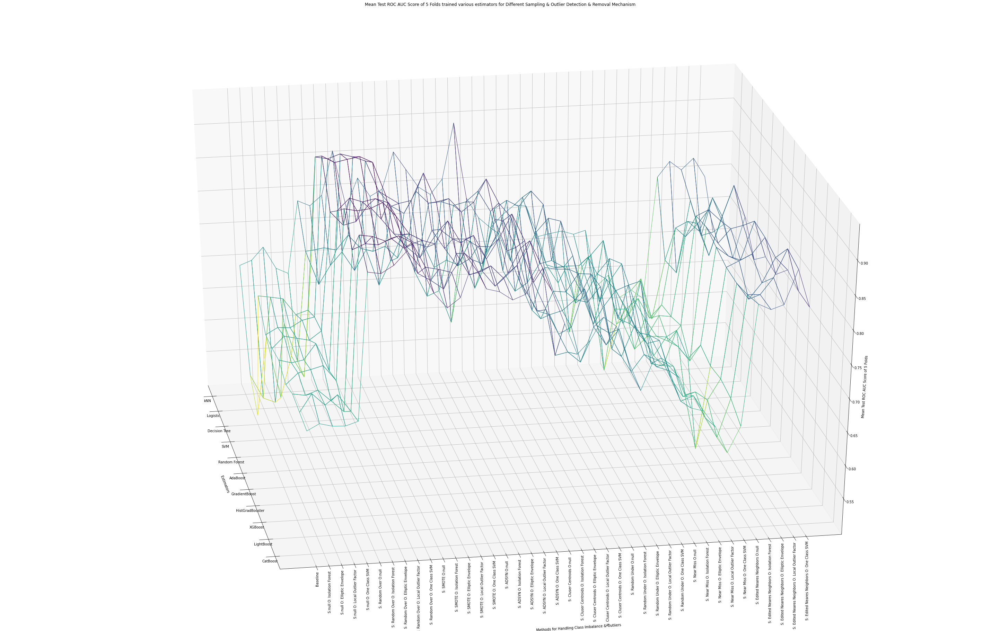

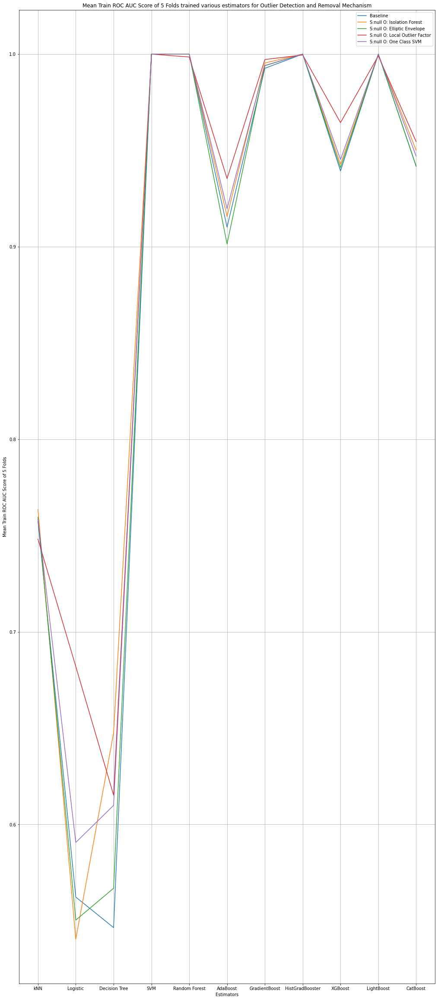

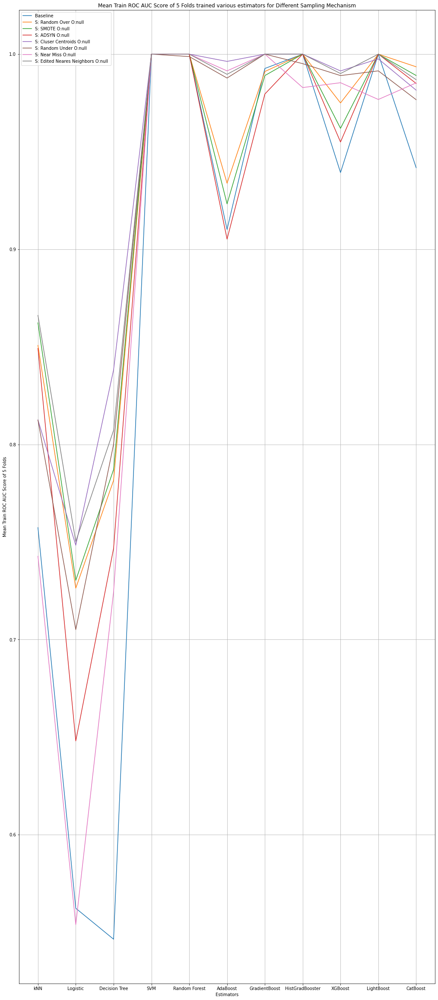

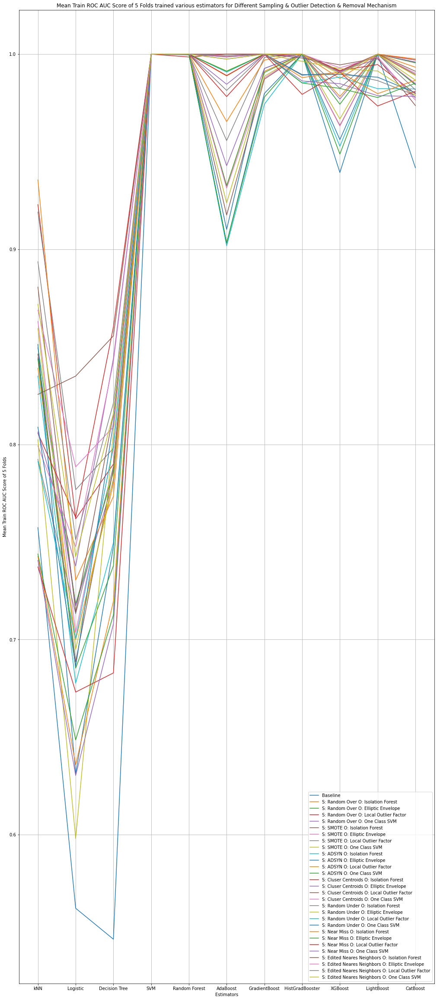

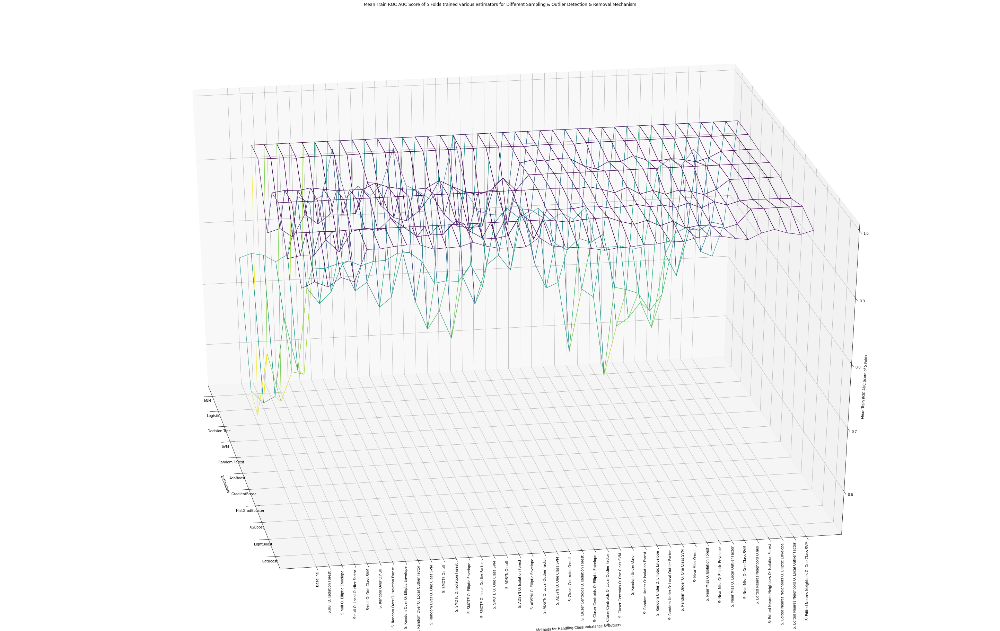

In [11]:
for n in range(len(matr)):
  conv(matr[n],mat_name[n])
%matplotlib inline
plt.close('all')

In [12]:
!zip -r /content/results.zip /content

  adding: content/ (stored 0%)
  adding: content/.config/ (stored 0%)
  adding: content/.config/active_config (stored 0%)
  adding: content/.config/gce (stored 0%)
  adding: content/.config/configurations/ (stored 0%)
  adding: content/.config/configurations/config_default (deflated 15%)
  adding: content/.config/logs/ (stored 0%)
  adding: content/.config/logs/2022.10.19/ (stored 0%)
  adding: content/.config/logs/2022.10.19/18.27.02.946426.log (deflated 54%)
  adding: content/.config/logs/2022.10.19/18.26.07.573597.log (deflated 54%)
  adding: content/.config/logs/2022.10.19/18.26.38.857916.log (deflated 53%)
  adding: content/.config/logs/2022.10.19/18.25.42.189207.log (deflated 91%)
  adding: content/.config/logs/2022.10.19/18.27.02.198159.log (deflated 55%)
  adding: content/.config/logs/2022.10.19/18.26.29.972197.log (deflated 86%)
  adding: content/.config/config_sentinel (stored 0%)
  adding: content/.config/.last_update_check.json (deflated 22%)
  adding: content/.config/.last

In [13]:
files.download('/content/results.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>